In [29]:
import numpy as np 
import pandas as pd 
from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
import plotly.express as px
init_notebook_mode(connected=True)
import plotly.graph_objs as go
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import seaborn as sns
import os



In [6]:
arr_1 = np.random.randn(50,4)
df_1 = pd.DataFrame(arr_1,columns=['A','B','C','D'])
df_1.head()

,A,B,C,D
0,0.494661,-0.047473,-0.402051,0.236956
1,-0.336509,-0.640901,-0.142603,1.366507
2,0.475715,-0.375774,-1.528094,-1.870601
3,-0.929313,-0.909902,-0.963260,-1.056131
4,0.610604,-1.110729,-0.371158,-0.746082


<Axes: >

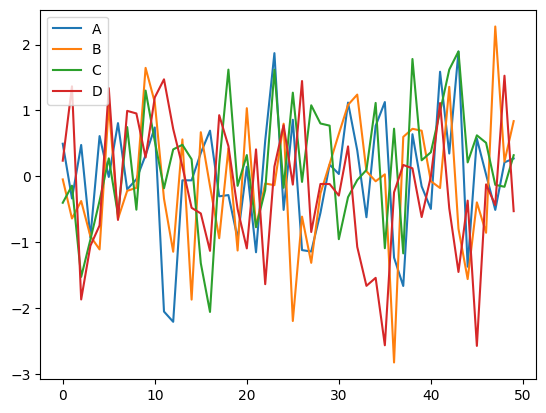

In [7]:
df_1.plot()

In [31]:
df_stocks = px.data.stocks()
df_stocks.head()
df_stocks.to_csv('all_stocks.csv',index=False)

In [9]:
px.line(df_stocks, x='date', y='AMZN',labels={'x':'Date','y':'Price'})

In [10]:
#Multiple line plot 
df_stocks = px.data.stocks()
px.line(df_stocks, x='date', y=['GOOG','AAPL'],
        labels={'x':'Date','y':'Price'},title='Apple vs.Google') 
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AAPL,mode='lines',name='Apple'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AMZN,mode='lines+markers',name='Amazon'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.FB,mode='lines+markers',name='Facebook'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.GOOG,mode='lines+markers',name='Google',
                        line=dict(color='firebrick',width=2,dash='dashdot')))
fig.update_layout(title='Stock Price data',xaxis_title='Price',yaxis_title='Date')

In [11]:
fig.update_layout(
xaxis=dict(
showline=True, showgrid=False , showticklabels=True,
    linecolor='rgb(204,204,204)',
    linewidth=2, ticks='outside',tickfont=dict(family='Arial',size=12,color='rgb(82,82,82)',
),
),
yaxis=dict(showgrid=False,zeroline=False,showline=False,showticklabels=False),
autosize=False,
margin=dict(
autoexpand=False, l=100 , r=100 , t=100,),
showlegend=False,plot_bgcolor='white')

In [33]:
df_us = px.data.gapminder().query("country == 'Pakistan'")
print(df_us)
df_us.to_csv("df_us.csv",index=False)
px.bar(df_us, x='year',y='pop')
#This bar chart shows population of Pakistan over period of time

       country continent  year  lifeExp        pop    gdpPercap iso_alpha  \
1164  Pakistan      Asia  1952   43.436   41346560   684.597144       PAK   
1165  Pakistan      Asia  1957   45.557   46679944   747.083529       PAK   
1166  Pakistan      Asia  1962   47.670   53100671   803.342742       PAK   
1167  Pakistan      Asia  1967   49.800   60641899   942.408259       PAK   
1168  Pakistan      Asia  1972   51.929   69325921  1049.938981       PAK   
1169  Pakistan      Asia  1977   54.043   78152686  1175.921193       PAK   
1170  Pakistan      Asia  1982   56.158   91462088  1443.429832       PAK   
1171  Pakistan      Asia  1987   58.245  105186881  1704.686583       PAK   
1172  Pakistan      Asia  1992   60.838  120065004  1971.829464       PAK   
1173  Pakistan      Asia  1997   61.818  135564834  2049.350521       PAK   
1174  Pakistan      Asia  2002   63.610  153403524  2092.712441       PAK   
1175  Pakistan      Asia  2007   65.483  169270617  2605.947580       PAK   

In [34]:
# Create a stacked bar with more customization
df_tips = px.data.tips()
df_tips.to_csv("df_tips.csv",index=False)
px.bar(df_tips, x='day', y='tip', color='sex', title='Tips by Sex on Each Day',
      labels={'tip': 'Tip Amount', 'day': 'Day of the Week'})

In [14]:
px.bar(df_tips, x="sex", y="total_bill",
             color='smoker', barmode='group')

In [35]:
# Display pop data for countries in Asia in 2007 greater than 2000000
df_asia = px.data.gapminder().query("continent == 'Asia' and year == 2007 and pop > 2.e6")
df_asia.to_csv("df_asia.csv",index=False)
fig = px.bar(df_asia, y='pop', x='country', text='pop', color='country')
# Put bar total value above bars with 2 values of precision
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')

In [16]:
# Set fontsize and uniformtext_mode='hide' says to hide the text if it won't fit
fig.update_layout(uniformtext_minsize=8)
# Rotate labels 45 degrees
fig.update_layout(xaxis_tickangle=-45)

In [3]:
df_iris=pd.read_csv("Iris.csv")
df_iris.head()

,Id,SepalLengthCm,SepalWidthCm,PetalLengthCm,PetalWidthCm,Species
0,1,5.1,3.5,1.4,0.2,Iris-setosa
1,2,4.9,3.0,1.4,0.2,Iris-setosa
2,3,4.7,3.2,1.3,0.2,Iris-setosa
3,4,4.6,3.1,1.5,0.2,Iris-setosa
4,5,5.0,3.6,1.4,0.2,Iris-setosa


In [4]:
# Create a scatter plot by defining x, y, different color for count of provided
# column, size based on supplied column and additional data to display on hover
px.scatter(df_iris, x="SepalWidthCm", y="SepalLengthCm", color="Species",
                 size='PetalLengthCm', hover_data=['PetalWidthCm'])

In [5]:
# Create a customized scatter with black marker edges with line width 2, opaque
# and colored based on width. Also show a scale on the right
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_iris.SepalWidthCm, y=df_iris.SepalLengthCm,
    mode='markers',
    marker_color=df_iris.SepalWidthCm,
    text=df_iris.Species,
    marker=dict(showscale=True)
))
fig.update_traces(marker_line_width=2, marker_size=10)

In [6]:
# Working with a lot of data use Scattergl
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(100000),
    y = np.random.randn(100000),
    mode='markers',
    marker=dict(
        color=np.random.randn(100000),
        colorscale='Viridis',
        line_width=1
    )
))
fig

In [36]:
# Create Pie chart of the largest nations in Asia
# Color maps here plotly.com/python/builtin-colorscales/
df_samer = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
df_samer.to_csv("df_samer.csv",index=False)
px.pie(df_samer, values='pop', names='country', 
       title='Population of Asian continent', 
       color_discrete_sequence=px.colors.sequential.RdBu)

In [8]:
# Customize pie chart
colors = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = go.Figure(data=[go.Pie(labels=['Water','Grass','Normal','Psychic', 'Fire', 'Ground'], 
                       values=[110,90,80,80,70,60])])
# Define hover info, text size, pull amount for each pie slice, and stroke
fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  textinfo='label+percent', pull=[0.1, 0, 0.2, 0, 0, 0],
                  marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)))

In [9]:
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 + dice_2
# bins represent the number of bars to make
# Can define x label, color, title
# marginal creates another plot (violin, box, rug)
fig = px.histogram(dice_sum, nbins=11, labels={'value':'Dice Roll'},
             title='5000 Dice Roll Histogram', marginal='violin',
            color_discrete_sequence=['blue'])
fig.update_layout(
    xaxis_title_text='Dice Roll',
    yaxis_title_text='Dice Sum',
    bargap=0.2, showlegend=False
)

In [10]:
# Stack histograms based on different column data
df_tips = px.data.tips()
px.histogram(df_tips, x="total_bill", color="sex")

In [11]:
# A box plot allows you to compare different variables
# The box shows the quartiles of the data. The bar in the middle is the median 
# The whiskers extend to all the other data aside from the points that are considered to be outliers
df_tips = px.data.tips()
# We can see which sex tips the most, points displays all the data points
px.box(df_tips, x='sex', y='tip', points='all')

In [12]:
# Display tip sex data by day
px.box(df_tips, x='day', y='tip', color='sex')

In [13]:
# Adding standard deviation and mean
fig = go.Figure()
fig.add_trace(go.Box(x=df_tips.sex, y=df_tips.tip, marker_color='blue',
                    boxmean='sd'))

In [14]:
# Complex Styling
df_stocks = px.data.stocks()
fig = go.Figure()
# Show all points, spread them so they don't overlap and change whisker width
fig.add_trace(go.Box(y=df_stocks.GOOG, boxpoints='all', name='Google',
                    fillcolor='blue', jitter=0.5, whiskerwidth=0.2))
fig.add_trace(go.Box(y=df_stocks.AAPL, boxpoints='all', name='Apple',
                    fillcolor='red', jitter=0.5, whiskerwidth=0.2))

In [15]:
# Change background / grid colors
fig.update_layout(title='Google vs. Apple', 
                  yaxis=dict(gridcolor='rgb(255, 255, 255)',
                 gridwidth=3),
                 paper_bgcolor='rgb(243, 243, 243)',
                 plot_bgcolor='rgb(243, 243, 243)')

In [16]:
# Violin Plot is a combination of the boxplot and KDE
# While a box plot corresponds to data points, the violin plot uses the KDE estimation
# of the data points
df_tips = px.data.tips()
px.violin(df_tips, y="total_bill", box=True, points='all')

In [17]:
# Multiple plots
px.violin(df_tips, y="tip", x="smoker", color="sex", box=True, points="all",
          hover_data=df_tips.columns)


In [18]:
# Morph left and right sides based on if the customer smokes
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'Yes' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'Yes' ],
                        legendgroup='Yes', scalegroup='Yes', name='Yes',
                        side='negative',
                        line_color='blue'))

In [19]:
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'No' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'No' ],
                        legendgroup='Yes', scalegroup='Yes', name='No',
                        side='positive',
                        line_color='red'))

In [39]:
# Create a heatmap using Seaborn data
flights = sns.load_dataset("flights")
flights.to_csv("flights.csv",index=False)
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


In [21]:
# You can set bins with nbinsx and nbinsy
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         color_continuous_scale="Viridis")
fig

In [22]:
# You can add histograms
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         marginal_x="histogram", marginal_y="histogram")
fig

In [23]:
# Create a 3D scatter plot using flight data
fig = px.scatter_3d(flights, x='year', y='month', z='passengers', color='year',
                   opacity=0.7, width=800, height=400)
fig

In [24]:
fig = px.line_3d(flights, x='year', y='month', z='passengers', color='year')
fig

In [25]:
# With a scatter matrix we can compare changes when comparing column data
fig = px.scatter_matrix(flights, color='month')
fig

In [40]:
# There are many interesting ways of working with maps
# plotly.com/python-api-reference/generated/plotly.express.scatter_geo.html
df = px.data.gapminder().query("year == 2007")
df.to_csv("df.csv",index=False)
fig = px.scatter_geo(df, locations="iso_alpha",
                     color="continent", # which column to use to set the color of markers
                     hover_name="country", # column added to hover information
                     size="pop", # size of markers
                     projection="orthographic")
fig

In [27]:
# You can color complex maps like we do here representing unemployment data

# Allows us to grab data from a supplied URL
from urllib.request import urlopen
# Used to decode JSON data
import json
# Grab US county geometry data
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Grab unemployment data based on each counties Federal Information Processing number
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig

In [41]:
# Polar charts display data radially 
# Let's plot wind data based on direction and frequency
# You can change size and auto-generate different symbols as well
df_wind = px.data.wind()
df_wind.to_csv("df_wind.csv",index=False)
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength",
                size="frequency", symbol="strength")

In [44]:
df_exp = px.data.experiment()
df_exp.to_csv("df_exp.csv",index=False)
px.scatter_ternary(df_exp, a="experiment_1", b="experiment_2", 
                   c='experiment_3', hover_name="group", color="gender")

In [46]:
# This dataframe provides scores for different students based on the level
# of attention they could provide during testing
att_df = sns.load_dataset("attention")
att_df.to_csv("att_df.csv",index=False)
fig = px.line(att_df, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')


In [ ]:
# Create an animated plot that you can use to cycle through continent
# GDP & life expectancy changes
df_cnt = px.data.gapminder()
df_cnt.to_csv("df_cnt.csv",index=False)

#